In [1]:
import pandas as pd
import os
from helper import plot_sample_images, plot_sample_images_multi, rgb_splitter
from util import convert_to_yolov5
import numpy as np

In [4]:
df_train, df_test = pd.read_csv('./Train.csv'), pd.read_csv('./Test.csv')
print(f"Training Data Shape:  {df_train.shape}\nTest Data Shape:      {df_test.shape}")

Training Data Shape:  (3906, 6)
Test Data Shape:      (931, 1)


In [5]:
df_train.Image_ID.nunique()

3001

In [6]:
df_train['is_train'] = df_train.Image_ID.map(lambda x: os.path.exists(f'Train_Images/{x}.jpg'))

In [7]:
df_train['class'].value_counts()

fruit_healthy      1638
fruit_woodiness    1246
fruit_brownspot    1022
Name: class, dtype: int64

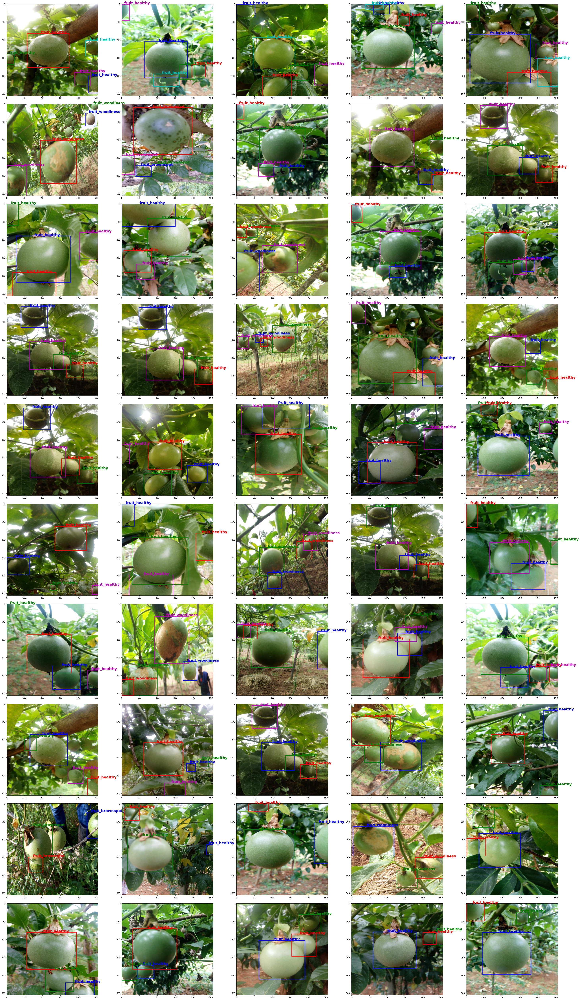

In [8]:
plot_sample_images_multi(df_train[df_train['is_train'] == True], top_n = 50, n_col = 5)

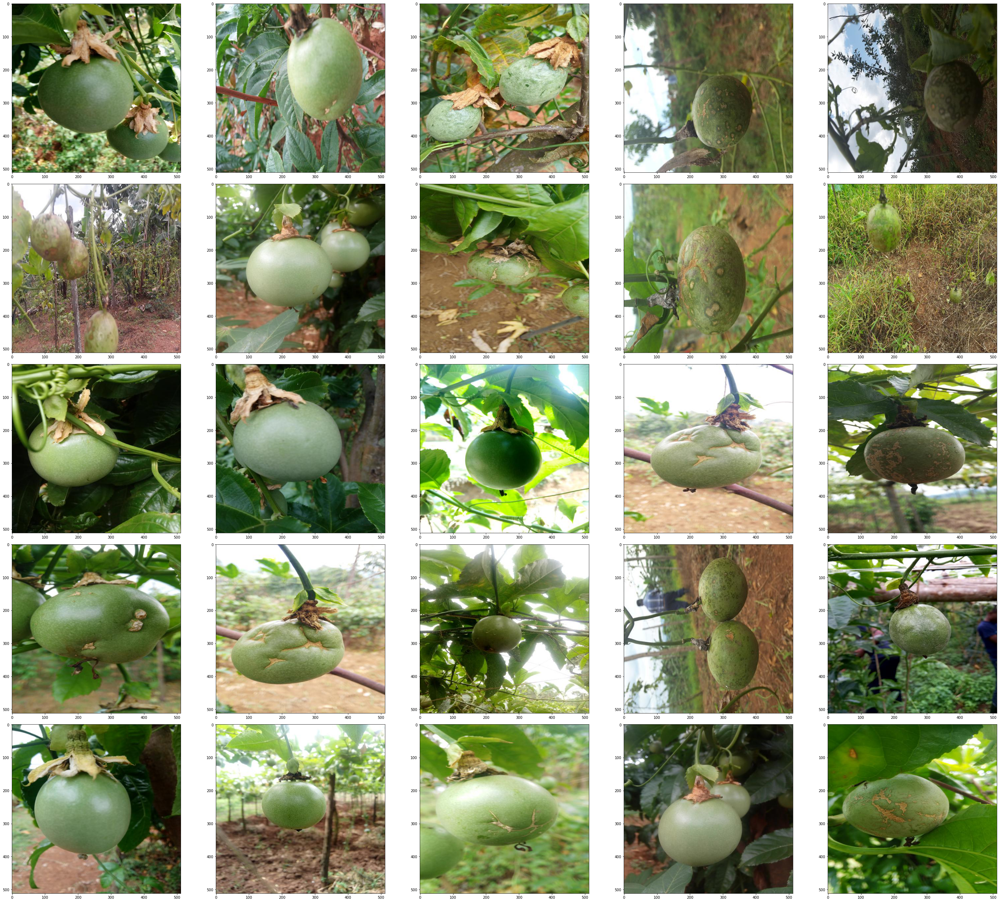

In [9]:
plot_sample_images_multi(df_test, show_label=False, is_train=False)

In [ ]:
regenerate_labels = False
if regenerate_labels:
    convert_to_yolov5(df_train)

In [ ]:
regenerate_train_val_split = True
if regenerate_train_val_split:
    np.random.seed(123)
    arrays = []
    for class_name in df_train['class'].unique():
        arrays.append(np.random.choice(df_train[df_train['class'] == class_name].Image_ID.unique(), 108))
    test_set_files = np.unique(np.concatenate(arrays))

    for file in test_set_files:
        print(f"Moving {file}....")
        os.rename(f"./Train_Images/{file}.jpg", f"./Val_Images/{file}.jpg")
        os.rename(f"./yolo5Input/{file}.txt", f"./Val_Labels/{file}.txt")

In [ ]:
rgb_splitter('ID_007FAIEI')

In [2]:
import matplotlib.image as img
from tqdm import tqdm

In [10]:
images = []
for img_id in tqdm(df_train.Image_ID.unique()):
    img_path = f'Train_Images/{img_id}.jpg'
    if os.path.exists(img_path):
        image = img.imread(img_path)
        images.append(image)
imgs_stack = np.stack(images, axis=0)

100%|██████████| 3001/3001 [00:12<00:00, 238.76it/s]


In [16]:
for i in range(3):
    rgb_list = ['Reds','Greens','Blues']
    print(f"{rgb_list[i]} Mean: {imgs_stack[:,:,:,i].mean()}\n")

Reds Mean: 120.32425647845879

Greens Mean: 134.9784270160016

Blues Mean: 89.0639983983814



In [17]:
for i in range(3):
    rgb_list = ['Reds','Greens','Blues']
    print(f"{rgb_list[i]} Stdev: {imgs_stack[:,:,:,i].std()}\n")

Reds Stdev: 61.805970138360536

Greens Stdev: 58.299900673252274

Blues Stdev: 63.776546953878345

